<a href="https://colab.research.google.com/github/kraseliukts/DataAnalysis/blob/main/OilWell_data_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Oil well´s data analysis
**Tatiana Kraseliuk**

## Library´s installation

In [ ]:
pip install plotly==6.0.0rc0

In [93]:
#import all necessary libraries
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from ipywidgets import widgets
import re

##Data transformations

In [94]:
#read csv file (loaded to google colab directly)
data=pd.read_csv("LGA-062.csv", delimiter=",")
data.head(2)

,Date,Time,VSD AMPS,MTR AMPS,VSD VOLTS,VSD FREQ,AI1 VALUE,AI2 VALUE,DC VOLTS,INTK PRESS,...,WIND TEMP,PUMP DIS,VIB X,VIB Y,LEAKAGE,AFE TEMP,VSD TEMP,SENS AMPS,SENS VOLTS,datetime
0,24/08/31,19:32:08,274.0,37.5,479.7,65.0,0,0.0,623.0,626.9,...,281.8,4128.8,1.17,0.19,10.0,0,41,0,119.8,2024-08-31 19:32:08
1,24/08/31,19:32:39,272.0,37.2,479.9,65.0,0,0.0,624.0,626.9,...,281.7,4128.2,1.09,0.19,10.0,0,41,0,120.3,2024-08-31 19:32:39


In [95]:
#convert the 'datetime', 'Date' and 'Time' columns to an appropiate format
data['datetime']=pd.to_datetime(data['datetime'])

data['Date']=pd.to_datetime(data['Date'], yearfirst=True, format='%y/%m/%d').dt.date
data['Date']=pd.to_datetime(data['Date'], format='%y/%m/%d')

data['Time']=pd.to_datetime(data['Time'], format='%H:%M:%S').dt.strftime('%H:%M:%S')

In [96]:
#set datetime as an index
data = data.set_index('datetime')
data = data.sort_index()

In [97]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 296206 entries, 2024-08-31 19:32:08 to 2024-12-16 06:28:16
Data columns (total 20 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   Date        296206 non-null  datetime64[ns]
 1   Time        296206 non-null  object        
 2   VSD AMPS    296206 non-null  float64       
 3   MTR AMPS    296206 non-null  float64       
 4   VSD VOLTS   296206 non-null  float64       
 5   VSD FREQ    296206 non-null  float64       
 6   AI1 VALUE   296206 non-null  int64         
 7   AI2 VALUE   296206 non-null  float64       
 8   DC VOLTS    296206 non-null  float64       
 9   INTK PRESS  296206 non-null  float64       
 10  INTK TEMP   296206 non-null  float64       
 11  WIND TEMP   296206 non-null  float64       
 12  PUMP DIS    296206 non-null  float64       
 13  VIB X       296206 non-null  float64       
 14  VIB Y       296206 non-null  float64       
 15  LEAKAGE     29620

In [98]:
#review the final dataset
data.head(2)

,Date,Time,VSD AMPS,MTR AMPS,VSD VOLTS,VSD FREQ,AI1 VALUE,AI2 VALUE,DC VOLTS,INTK PRESS,INTK TEMP,WIND TEMP,PUMP DIS,VIB X,VIB Y,LEAKAGE,AFE TEMP,VSD TEMP,SENS AMPS,SENS VOLTS
datetime,,,,,,,,,,,,,,,,,,,,
2024-08-31 19:32:08,2024-08-31,19:32:08,274.0,37.5,479.7,65.0,0,0.0,623.0,626.9,236.1,281.8,4128.8,1.17,0.19,10.0,0,41,0,119.8
2024-08-31 19:32:39,2024-08-31,19:32:39,272.0,37.2,479.9,65.0,0,0.0,624.0,626.9,236.2,281.7,4128.2,1.09,0.19,10.0,0,41,0,120.3


In [99]:
data.tail(2)

,Date,Time,VSD AMPS,MTR AMPS,VSD VOLTS,VSD FREQ,AI1 VALUE,AI2 VALUE,DC VOLTS,INTK PRESS,INTK TEMP,WIND TEMP,PUMP DIS,VIB X,VIB Y,LEAKAGE,AFE TEMP,VSD TEMP,SENS AMPS,SENS VOLTS
datetime,,,,,,,,,,,,,,,,,,,,
2024-12-16 06:14:20,2024-12-16,06:14:20,0.0,0.0,0.0,0.0,0,0.0,678.0,0.0,32.0,32.0,0.0,0.0,0.0,22.0,0,35,0,24.6
2024-12-16 06:28:16,2024-12-16,06:28:16,0.0,0.0,0.0,0.0,0,0.0,676.0,0.0,32.0,32.0,0.0,0.0,0.0,0.0,0,32,0,120.1


## Data visualizations

### Well name input

In [100]:
well_name=input("Please enter the oil well name: ")

Please enter the oil well name: Well_001


In [101]:
#define the columns for visualizations
print(data.columns)
columns_1=['INTK PRESS', 'PUMP DIS', 'INTK TEMP', 'WIND TEMP']
columns_2=['VIB X', 'VIB Y']
columns_3=['VSD FREQ', 'MTR AMPS']

Index(['Date', 'Time', 'VSD AMPS', 'MTR AMPS', 'VSD VOLTS', 'VSD FREQ',
       'AI1 VALUE', 'AI2 VALUE', 'DC VOLTS', 'INTK PRESS', 'INTK TEMP',
       'WIND TEMP', 'PUMP DIS', 'VIB X', 'VIB Y', 'LEAKAGE', 'AFE TEMP',
       'VSD TEMP', 'SENS AMPS', 'SENS VOLTS'],
      dtype='object')


### Static graphics

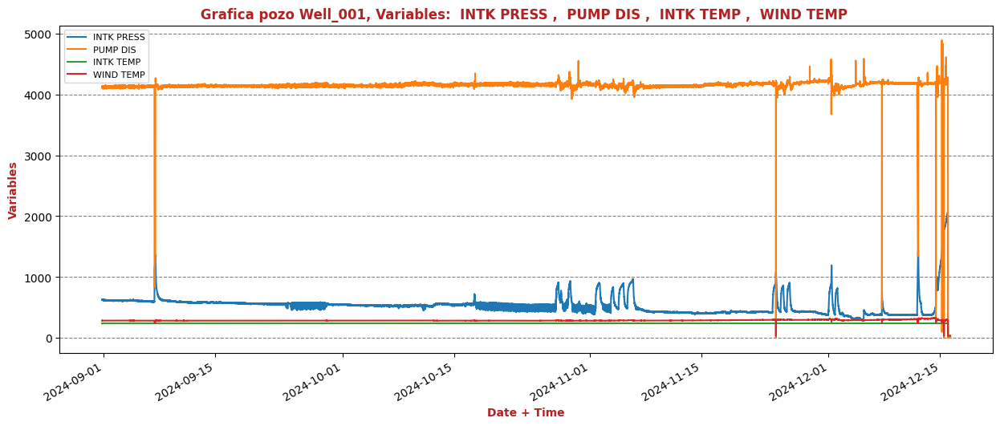

In [102]:
fig, ax=plt.subplots(figsize=(15, 6))

data[columns_1].plot(ax=ax, label='Grafica #1')

ax.set_title(' Grafica pozo ' +str(well_name)+ ', Variables:' +re.sub("[\[|\]|']|\s+|\.|\-", ' ', str(list(data[columns_1].columns))), loc = "Center", fontdict = {'fontsize':12, 'fontweight':'bold', 'color':'firebrick'})

ax.set_xlabel("Date + Time", fontdict = {'fontsize':10, 'fontweight':'bold', 'color':'firebrick'})
ax.set_ylabel("Variables", fontdict = {'fontsize':10, 'fontweight':'bold', 'color':'firebrick'})

ax.legend(prop={'size': 8}, loc = 'upper left')
ax.grid(axis = 'y', color = 'gray', linestyle = 'dashed')

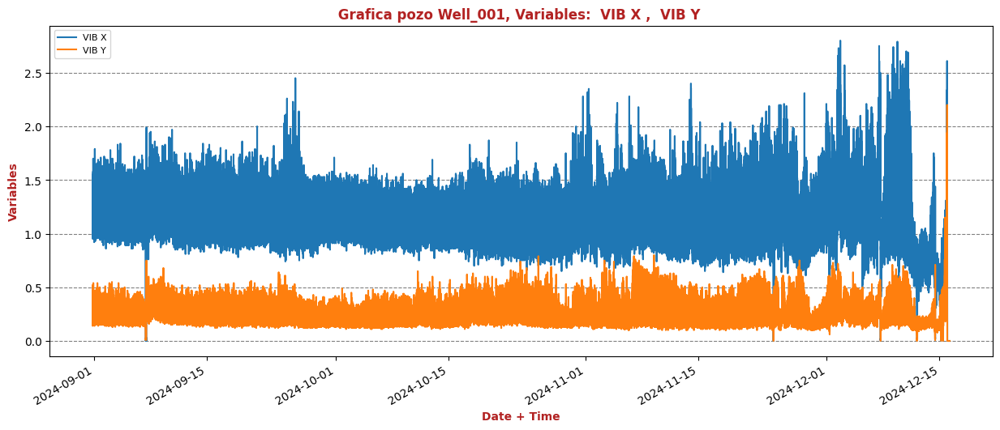

In [103]:
fig, ax=plt.subplots(figsize=(15, 6))

data[columns_2].plot(ax=ax, label='Grafica #2')

ax.set_title(' Grafica pozo ' +str(well_name)+ ', Variables:' +re.sub("[\[|\]|']|\s+|\.|\-", ' ', str(list(data[columns_2].columns))), loc = "Center", fontdict = {'fontsize':12, 'fontweight':'bold', 'color':'firebrick'})

ax.set_xlabel("Date + Time", fontdict = {'fontsize':10, 'fontweight':'bold', 'color':'firebrick'})
ax.set_ylabel("Variables", fontdict = {'fontsize':10, 'fontweight':'bold', 'color':'firebrick'})

ax.legend(prop={'size': 8}, loc = 'upper left')
ax.grid(axis = 'y', color = 'gray', linestyle = 'dashed')

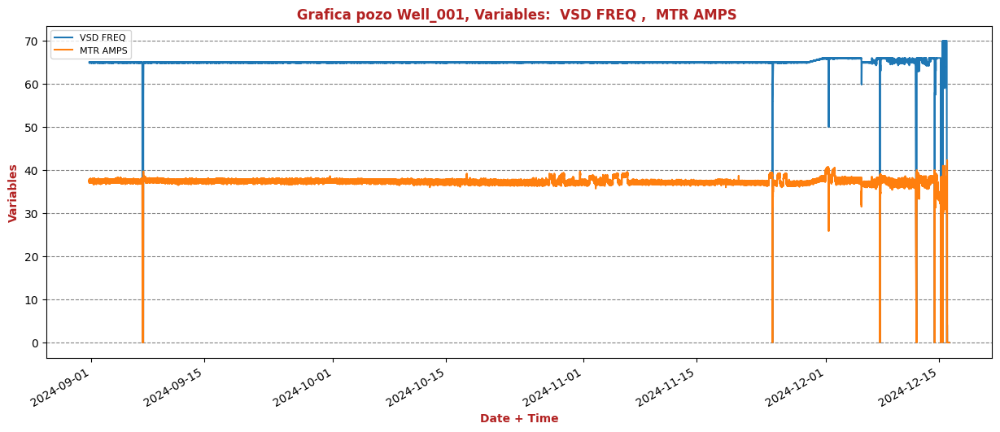

In [104]:
fig, ax=plt.subplots(figsize=(15, 6))

data[columns_3].plot(ax=ax, label='Grafica #3')

ax.set_title(' Grafica pozo ' +str(well_name)+ ', Variables:' +re.sub("[\[|\]|']|\s+|\.|\-", ' ', str(list(data[columns_3].columns))), loc = "Center", fontdict = {'fontsize':12, 'fontweight':'bold', 'color':'firebrick'})

ax.set_xlabel("Date + Time", fontdict = {'fontsize':10, 'fontweight':'bold', 'color':'firebrick'})
ax.set_ylabel("Variables", fontdict = {'fontsize':10, 'fontweight':'bold', 'color':'firebrick'})

ax.legend(prop={'size': 8}, loc = 'upper left')
ax.grid(axis = 'y', color = 'gray', linestyle = 'dashed')

### Interactive graphics

In [108]:
#define the 1st variables to show
column_4=data['VSD AMPS']

#create and visualize the graphic
plot = go.Figure(
    data=[go.Scatter(
    x=data.index,
    y=column_4,
    mode='lines',
    line=dict(color="#0000ff"))
])

plot.update_layout(hovermode="x unified", template='plotly_white',
    xaxis_title='Date + Time',
    yaxis_title='Variable',
    title=' Grafica pozo ' +str(well_name),
    title_font_size=20)

plot.update_layout(
    updatemenus=[
        {
            'buttons': [
                {
                    'label': 'VSD AMPS',
                    'method': 'update',
                    'args': [{'y': [data['VSD AMPS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: VSD AMPS'}]
                },
                                {
                    'label': 'MTR AMPS',
                    'method': 'update',
                    'args': [{'y': [data['MTR AMPS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: MTR AMPS'}]
                },
                                {
                    'label': 'VSD VOLTS',
                    'method': 'update',
                    'args': [{'y': [data['VSD VOLTS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: VSD VOLTS'}]
                },
                                {
                    'label': 'VSD FREQ',
                    'method': 'update',
                    'args': [{'y': [data['VSD FREQ']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: VSD FREQ'}]
                },
                                {
                    'label': 'AI1 VALUE',
                    'method': 'update',
                    'args': [{'y': [data['AI1 VALUE']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: AI1 VALUE'}]
                },
                                {
                    'label': 'AI2 VALUE',
                    'method': 'update',
                    'args': [{'y': [data['AI2 VALUE']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: AI2 VALUE'}]
                },
                {
                    'label': 'DC VOLTS',
                    'method': 'update',
                    'args': [{'y': [data['DC VOLTS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: DC VOLTS'}]
                },
                {
                    'label': 'INTK PRESS',
                    'method': 'update',
                    'args': [{'y': [data['INTK PRESS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: INTK PRESS'}]
                },
                {
                    'label': 'WIND TEMP',
                    'method': 'update',
                    'args': [{'y': [data['WIND TEMP']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: WIND TEMP'}]
                },
                                {
                    'label': 'PUMP DIS',
                    'method': 'update',
                    'args': [{'y': [data['PUMP DIS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: PUMP DIS'}]
                },
                                {
                    'label': 'VIB X',
                    'method': 'update',
                    'args': [{'y': [data['VIB X']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: VIB X'}]
                },
                                {
                    'label': 'VIB Y',
                    'method': 'update',
                    'args': [{'y': [data['VIB Y']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: VIB Y'}]
                },
                                {
                    'label': 'LEAKAGE',
                    'method': 'update',
                    'args': [{'y': [data['LEAKAGE']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: LEAKAGE'}]
                },
                                {
                    'label': 'AFE TEMP',
                    'method': 'update',
                    'args': [{'y': [data['AFE TEMP']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: AFE TEMP'}]
                },
                                {
                    'label': 'VSD TEMP',
                    'method': 'update',
                    'args': [{'y': [data['VSD TEMP']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: VSD TEMP'}]
                },
                                {
                    'label': 'SENS AMPS',
                    'method': 'update',
                    'args': [{'y': [data['SENS AMPS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: SENS AMPS'}]
                },
                                                {
                    'label': 'SENS VOLTS',
                    'method': 'update',
                    'args': [{'y': [data['SENS VOLTS']]}, {'title': 'Grafica pozo ' +str(well_name) + ' Variable: SENS VOLTS'}]
                },


            ],
            'direction': 'down',
            'showactive': True,
        }
    ]
)


plot.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=7,
                    step="day",
                    stepmode="backward"),
                dict(count=14,
                    step="day",
                    stepmode="backward"),
                dict(count=1,
                    step="month",
                    stepmode="backward"),
                dict(count=6,
                    step="month",
                    stepmode="backward"),
                dict(step="all"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
    )
)


plot.show()